In [40]:
# IMPORT PYTHON PACKAGES

# basic data science
import pandas as pd
import numpy as np
import random         # random number generator
from datetime import timedelta       # handling datetime data

# logistic regression model and auc score metrics
from sklearn import metrics
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split

# plotting
import matplotlib.pyplot as plt
import plotly.graph_objects as go

In [41]:
# (look at raw data) 
seizures = pd.read_csv('data/P23_seizure_diary.csv')
heart_rate = pd.read_csv('data/P23_heart_rate_data.csv')

seizure_timestamps = pd.to_datetime(seizures['seconds_since_hr_recording'], unit = 's')
heart_rate['timestamps'] = pd.to_datetime(heart_rate['seconds_since_hr_recording'], unit = 's')

hr_smoothed = heart_rate.rolling(window='D', on='timestamps').mean()['value']
hr_hourly = heart_rate.resample('H', on='timestamps').mean().reset_index()['value']

fig = go.Figure()
fig.add_trace(
        go.Scatter(x=heart_rate['timestamps'], y=hr_smoothed, mode='lines', name='likelihood',
                   line={'color': 'rgb(115,115,115)'}))
fig.add_trace(
        go.Scatter(x=seizure_timestamps, y=[hr_smoothed.max()] * len(seizure_timestamps), mode='markers', name='seizures',
                   line={'color': 'red'}, marker={'size': 10}, marker_symbol='triangle-down'))

In [42]:
# heart rate before seizures
hr_logistic_regression = heart_rate.resample('H', on='timestamps').mean().reset_index()
hr_logistic_regression = hr_logistic_regression[hr_logistic_regression['timestamps'] 
                                                > min(seizure_timestamps).floor(freq='H')]
hr_timestamps = hr_logistic_regression['timestamps']
seizure_hour = [time.floor(freq = 'H') for time in seizure_timestamps]

fig = go.Figure()
fig.add_trace(
        go.Scatter(x=hr_timestamps, y=hr_logistic_regression['value'], mode='lines', name='likelihood',
                   line={'color': 'rgb(115,115,115)'}))
fig.add_trace(
        go.Scatter(x=seizure_hour, y=[hr_logistic_regression['value'].max()] * len(seizure_hour), mode='markers', name='seizures',
                   line={'color': 'red'}, marker={'size': 10}, marker_symbol='triangle-down'))

In [43]:
# indicator function (ground truth)
y = [0 if time not in seizure_hour else 1 for time in hr_timestamps]

In [44]:
fig1 = go.Figure()
fig1.add_trace(
        go.Scatter(x=hr_timestamps, y=y, mode='lines', name='indicator',
                   line={'color': 'red'}))

In [45]:
# normalise HR data
X = hr_logistic_regression['value']
X[pd.isnull(X)] = np.nanmean(X)
X = (X - np.nanmean(X)) / np.nanstd(X)

In [46]:
fig2 = go.Figure()
fig2.add_trace(
        go.Scatter(x=hr_timestamps, y=X, mode='lines', name='heart rate',
                   line={'color': 'rgb(115,115,115)'}))

In [47]:
# ODDS RATIO

X = X.to_numpy().reshape(-1, 1)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=0)
logreg = LogisticRegression()
logreg.fit(X_train, y_train)

print('odds ratio: ' + str(np.exp(logreg.coef_[0][0])))

odds ratio: 1.5236632591194461


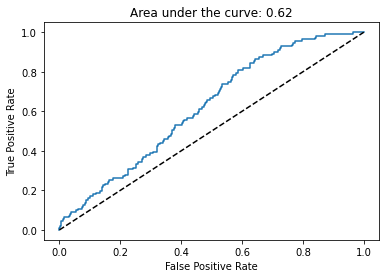

In [48]:
# COMPUTE AUC SCORE
logit_roc_auc = metrics.roc_auc_score(y_test, logreg.predict_proba(X_test)[:,1])
fpr, tpr, thresholds = metrics.roc_curve(y_test, logreg.predict_proba(X_test)[:,1])

#create ROC curve
plt.plot(fpr,tpr)
plt.plot([0,1], [0,1], '--k')
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.title('Area under the curve: ' + str(round(logit_roc_auc,2)))
plt.show()

In [50]:
# load forecasts (prepared earlier)
likelihoods = pd.read_csv('data/P23_likelihoods.csv')

timestamps = pd.to_datetime(likelihoods['timestamps'], unit = 'ms')
likelihoods = likelihoods['likelihoods']

test_seizures = seizure_timestamps[seizure_timestamps > timestamps.min()]
test_seizure_hour = [time.floor(freq = 'H') for time in test_seizures]

y_true = [1 for seizure in test_sei]

In [51]:
# plot data
fig = go.Figure()
fig.add_trace(
        go.Scatter(x=timestamps, y=likelihoods, mode='lines', name='likelihood',
                   line={'color': 'rgb(115,115,115)'}))
fig.add_trace(
        go.Scatter(x=test_seizures, y=[1] * len(test_seizures), mode='markers', name='seizures',
                   line={'color': 'red'}, marker={'size': 10}, marker_symbol='triangle-down'))

# update figure layout
fig.update_layout(
    xaxis_title='Date', yaxis_title='Seizure likelihood', xaxis={
        'range': [min(timestamps) - timedelta(days=1),
                  max(timestamps) + timedelta(days=1)],
        'autorange': False
    }, yaxis={
        'range': [-0.05, 1.05],
        'autorange': False
    }, margin={
        'b': 10,
        'l': 10,
        'r': 10,
        't': 10
    })



In [52]:
# Deterministic evaluation
# set a naive threshold
high_risk_thresh = np.percentile(likelihoods, 75)
print(high_risk_thresh)

0.3562464302055794


In [37]:
# sensitivity & specificity using thresholds

tn, fp, fn, tp = metrics.confusion_matrix(y_test, (likelihoods.to_numpy() > high_risk_thresh).astype(int)).ravel()
sensitivity = tp / (tp + fn)
specificity = tn / (tn + fp)

print(sensitivity)
print(specificity)

ValueError: Found input variables with inconsistent numbers of samples: [2737, 9072]

In [38]:
# time in warning
tiw = sum(likelihoods.to_numpy() > high_risk_thresh) / len(likelihoods)
print(tiw)

0.25


In [39]:
# forecast horizon
high_risk = []
risk_times = timestamps.to_list()

for true_sz in test_seizures:
    round_sz = true_sz.floor(freq = 'H')
    i = risk_times.index(round_sz)

    if likelihoods[i] >= high_risk_thresh:
        time_in_high = (true_sz - round_sz).total_seconds() / 3600   # time in hours
        j = 1
        while (i - j) >= 0 and likelihoods[i - j] >= high_risk_thresh and y_true[i - j] == 0:
            time_in_high += 1
            j += 1
        high_risk.append(time_in_high)
        
print(np.nanmean(high_risk))

# plot distribution of horizons
fig = go.Figure()
fig.add_trace(go.Histogram(x=high_risk))

NameError: name 'y_true' is not defined

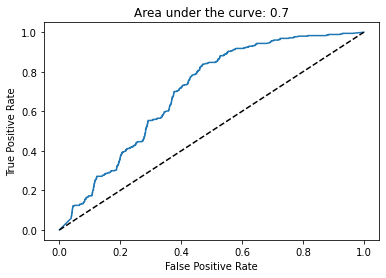

In [75]:
# The AUC

fpr, tpr, _ = metrics.roc_curve(y_true,  likelihoods)
auc = metrics.roc_auc_score(y_true, likelihoods)

#create ROC curve
plt.plot(fpr,tpr)
plt.plot([0,1], [0,1], '--k')
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.title('Area under the curve: ' + str(round(auc,2)))
plt.show()